# Dataset Creation

In [133]:
import pandas as pd
import numpy as np
import random
import plotly.express as px
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
import warnings
warnings.filterwarnings('ignore')

# graph settings : 
sns.set_style('darkgrid')
matplotlib.rcParams['font.size'] = 14
matplotlib.rcParams['figure.figsize'] = (10, 6)
matplotlib.rcParams['figure.facecolor'] = '#00000000'

In [101]:
def randomNumber(x):
    return random.randint(0,x)
def randomDate(x):
    return random.randint(5,x)
def randomYear(x):
    return random.randint(1,x)
def randomColor():
    r = lambda: random.randint(0,255)
    return ('#%02X%02X%02X' % (r(),r(),r()))
def randomDateCust():
    return random.randint(1,2)


In [102]:
# for ground owners
#(date-pk,year(not required),day, month, week number , groundName, timeslot chosen , sport chosen ) --> cost spent

years = ['2010','2011','2012','2013','2014','2015','2016','2017','2018','2019','2020','2021']

days = ['Monday','Tuesday','Wednesday','Thursday','Friday','Saturday','Sunday']

groundNames = ['Ground1','Ground2','Ground3','Ground4']

timeslots = ['timeslot1','timeslot2','timeslot3','timeslot4','timeslot5','timeslot6','timeslot7']

months = ['January','February','March','April','May','June','July','August','September','October','November','December']

sports = ['sport1','sport2','sport3','sport4','sport5','sport6']

#for ground 1 : 
g1_prices = {'sport1':100,'sport2':150,'sport3':250,'sport4':350,'sport5':400,'sport6':200}
g2_prices = {'sport1':200,'sport2':150,'sport3':450,'sport4':250,'sport5':200,'sport6':100}
g3_prices = {'sport1':350,'sport2':450,'sport3':150,'sport4':200,'sport5':300,'sport6':250}
g4_prices = {'sport1':450,'sport2':250,'sport3':150,'sport4':100,'sport5':250,'sport6':500}


data = [] 
data2=[]
# assuming on an average,30 people and minimum 5 people visit the ground everyday 
for i in range(1,3000):  
    num_dates = randomDate(30)
    tot_cost=0
    tYear =""
    tDay=""
    tGroundName=""
    tTimeSlot=""
    tMonth =""
    tSport=""
    tDate = i
    tot_cust = num_dates
    day_cost = []
    
    for j in range(1,tot_cust):    
        tDay = days[randomNumber(len(days)-1)]
        tGroundName = groundNames[randomNumber(len(groundNames)-1)]
        tTimeSlot = timeslots[randomNumber(len(timeslots)-1)]
        tSport = sports[randomNumber(len(sports)-1)]
        tMonth = months[randomNumber(len(months)-1)]
        if(tGroundName == 'Ground1'):
            tCost = g1_prices[tSport]
            day_cost.append(tCost)
            tot_cost+=tCost
        elif(tGroundName == 'Ground2'):
            tCost = g2_prices[tSport]
            day_cost.append(tCost)
            
            tot_cost+=tCost
        elif(tGroundName == 'Ground3'):
            tCost = g3_prices[tSport]
            day_cost.append(tCost)
            
            tot_cost+=tCost
        elif(tGroundName == 'Ground4'):
            tCost = g4_prices[tSport]
            day_cost.append(tCost)
            
            tot_cost+=tCost
        if(i<250):
            tYear = years[0]
        elif(i>=250 and i<500):
            tYear = years[1]
        elif(i>=500 and i<750):
            tYear = years[2]
        elif(i>=750 and i<1000):
            tYear = years[3]
        elif(i>=1000 and i<1250):
            tYear = years[4]
        elif(i>=1250 and i<1500):
            tYear = years[5]
        elif(i>=1500 and i<1750):
            tYear = years[6]
        elif(i>=1750 and i<2000):
            tYear = years[7]
        elif(i>=2000 and i<2250):
            tYear = years[8]
        elif(i>=2250 and i<2500):
            tYear = years[9]
        elif(i>=2500 and i<2750):
            tYear = years[10]
        elif(i>=2750 and i<3000):
            tYear = years[11]
        
            
        
            
    
    data.append([tDate,tYear,tDay,tMonth,tGroundName,tot_cost,tot_cust])
    for i in range(1,tot_cust):
        tTimeSlot = timeslots[randomNumber(len(timeslots)-1)]
        tSport = sports[randomNumber(len(sports)-1)]
        data2.append([tDate,tYear,tDay,tMonth,tTimeSlot,tSport,tGroundName,day_cost[i-1]])

groundOwners_df = pd.DataFrame(data, columns = ['Date','Year', 'Day','Month','GroundName','Cost','TotalCustomers'])

groundOwners_df_percust = pd.DataFrame(data2,columns = ['Date','Year', 'Day','Month','TimeSlot','Sport','GroundName','Cost'])

In [103]:
groundOwners_df

,Date,Year,Day,Month,GroundName,Cost,TotalCustomers
0,1,2010,Thursday,October,Ground4,5850,24
1,2,2010,Friday,February,Ground1,6200,25
2,3,2010,Thursday,September,Ground2,4400,17
3,4,2010,Thursday,November,Ground2,5300,22
4,5,2010,Tuesday,August,Ground2,1350,8
...,...,...,...,...,...,...,...
2994,2995,2021,Monday,June,Ground4,1400,7
2995,2996,2021,Thursday,January,Ground1,1400,8
2996,2997,2021,Sunday,January,Ground3,5500,22
2997,2998,2021,Sunday,March,Ground2,4600,17


In [104]:
groundOwners_df_percust

,Date,Year,Day,Month,TimeSlot,Sport,GroundName,Cost
0,1,2010,Thursday,October,timeslot7,sport6,Ground4,350
1,1,2010,Thursday,October,timeslot6,sport5,Ground4,250
2,1,2010,Thursday,October,timeslot7,sport4,Ground4,300
3,1,2010,Thursday,October,timeslot7,sport3,Ground4,200
4,1,2010,Thursday,October,timeslot5,sport6,Ground4,250
...,...,...,...,...,...,...,...,...
49743,2999,2021,Thursday,February,timeslot3,sport3,Ground2,250
49744,2999,2021,Thursday,February,timeslot6,sport1,Ground2,250
49745,2999,2021,Thursday,February,timeslot5,sport6,Ground2,450
49746,2999,2021,Thursday,February,timeslot4,sport4,Ground2,100


In [105]:
gO1_Cost_df = groundOwners_df.loc[groundOwners_df['GroundName'] == 'Ground1']
gO2_Cost_df = groundOwners_df.loc[groundOwners_df['GroundName'] == 'Ground2']
gO3_Cost_df = groundOwners_df.loc[groundOwners_df['GroundName'] == 'Ground3']
gO4_Cost_df = groundOwners_df.loc[groundOwners_df['GroundName'] == 'Ground4']

gO1_Cust_df = groundOwners_df_percust.loc[groundOwners_df_percust['GroundName'] == 'Ground1']
gO2_Cust_df = groundOwners_df_percust.loc[groundOwners_df_percust['GroundName'] == 'Ground2']
gO3_Cust_df = groundOwners_df_percust.loc[groundOwners_df_percust['GroundName'] == 'Ground3']
gO4_Cust_df = groundOwners_df_percust.loc[groundOwners_df_percust['GroundName'] == 'Ground4']



In [106]:
# gO1_Cost_df
# gO2_Cost_df
# gO3_Cost_df
# gO4_Cost_df

# gO1_Cust_df
# gO2_Cust_df
# gO3_Cust_df
# gO4_Cust_df

# Analytics of Dataset 

In [107]:
#for cost regression for all grounds: 
def HistCreateCostCategorical(gDF,x,cat):
    col_dis_seq = []
    for i in range(0,x):
        col_dis_seq.append(randomColor())
    fig = px.histogram(gDF, 
                       x='Cost', 
                       marginal='box', 
                       color=cat, 
                       color_discrete_sequence=col_dis_seq, 
                       title='Revenue of Ground based on '+cat)
    
    fig.update_layout(bargap=0.1)
    fig.show()

def HistCreateCategorical(gDF,cat):
    fig = px.histogram(gDF,x=cat,title="Number of people by "+cat)
    fig.show()

def HistCreateTwoCategorical(gDF,cat,secondCat):
    fig = px.histogram(gDF,x=cat,color=secondCat,title="Number of people by "+cat+" and"+secondCat)
    fig.show()
    

    
def CostWithOtherVars(gDF):
    fig = px.scatter(gDF,
                    x=other_var)

    
def FindCorrWithCost(gDF):
    day_values ={'Monday':0,'Tuesday':1,'Wednesday':2,'Thursday':3,'Friday':4,'Saturday':5,'Sunday':6}

    timeslot_values = {'timeslot1':0,'timeslot2':1,'timeslot3':2,'timeslot4':3,'timeslot5':4,'timeslot6':5,'timeslot7':6}

    month_values = {'January':0,'February':1,'March':2,'April':3,'May':4,'June':5,'July':6,'August':7,'September':8,'October':9,'November':10,'December':11}

    sport_values = {'sport1':0,'sport2':1,'sport3':2,'sport4':3,'sport5':4,'sport6':5}


    day_numeric =groundOwner1_df["Day"].map(day_values)
    print("Day with Cost :")
    print(groundOwner1_df["Cost"].corr(day_numeric))


    month_numeric =groundOwner1_df["Month"].map(month_values)
    print("Month with Cost :")
    print(groundOwner1_df["Cost"].corr(month_numeric))

    timeslot_numeric =groundOwner1_df["TimeSlot"].map(timeslot_values)
    print("TimeSlot with Cost :")
    print(groundOwner1_df["Cost"].corr(timeslot_numeric))

    sport_numeric =groundOwner1_df["Sport"].map(sport_values)
    print("Sport with Cost :")
    print(groundOwner1_df["Cost"].corr(sport_numeric))
    
    
def AnalyticsPipeline1(gDF):
    print(gDF)
    print("\nInformation about the Data for Ground")
    gDF.info()
    print("\nStatistics about the Revenue Data for Ground")
    print(gDF.describe())
    fig = px.histogram(gDF, 
                   x='Cost', 
                   marginal='box', 
                   nbins=47, 
                   title='Distribution of Cost')
    fig.update_layout(bargap=0.1)
    fig.show()
    print("\nDistribution of Cost with Categorical Variables")
    HistCreateCostCategorical(gDF,11,'Year')
    HistCreateCostCategorical(gDF,11,'Month')
    HistCreateCostCategorical(gDF,11,'Day')
    
    print("\nDistribution of Categorical Variables")
    HistCreateCategorical(gDF,'Year')
    HistCreateCategorical(gDF,'Month')
    HistCreateCategorical(gDF,'Day')
    
    print("\nDistribution of Two Categorical Variables")
    HistCreateTwoCategorical(gDF,'Year','Month')
    HistCreateTwoCategorical(gDF,'Month','Day')
    
    
    print("\nRelationship of Day with Cost")
    temp_fig =px.violin(gDF,x="Day",y="Cost",color="Month")
    temp_fig.show()

    print("\nRelationship of Month with Cost")
    temp_fig =px.violin(gDF,x="Month",y="Cost",color="Year")
    temp_fig.show()
    
   
    
#     print("\nFinding Correlation of Day,Month,TimeSlot,Sport with Cost")
#     FindCorrWithCost(gDF)
    



    
def AnalyticsPipeline2(gDF):
    print(gDF)
    print("\nInformation about the Data for Ground")
    gDF.info()
    print("\nStatistics about the Revenue Data for Ground")
    print(gDF.describe())
    fig = px.histogram(gDF, 
                   x='Cost', 
                   marginal='box', 
                   nbins=47, 
                   title='Distribution of Cost')
    fig.update_layout(bargap=0.1)
    fig.show()
    print("\nDistribution of Cost with Categorical Variables")
    HistCreateCostCategorical(gDF,11,'Year')
    HistCreateCostCategorical(gDF,11,'Month')
    HistCreateCostCategorical(gDF,11,'Day')
    HistCreateCostCategorical(gDF,11,'TimeSlot')
    HistCreateCostCategorical(gDF,11,'Sport')
    
    print("\nDistribution of Categorical Variables")
    HistCreateCategorical(gDF,'Year')
    HistCreateCategorical(gDF,'Month')
    HistCreateCategorical(gDF,'Day')
    HistCreateCategorical(gDF,'TimeSlot')
    HistCreateCategorical(gDF,'Sport')
    
    print("\nDistribution of Two Categorical Variables")
    HistCreateTwoCategorical(gDF,'Year','Month')
    HistCreateTwoCategorical(gDF,'Month','Day')
    HistCreateTwoCategorical(gDF,'Day','TimeSlot')
    HistCreateTwoCategorical(gDF,'Day','Sport')
    HistCreateTwoCategorical(gDF,'Sport','TimeSlot')
    
    
    print("\nRelationship of Day with Cost")
    temp_fig =px.violin(gDF,x="Day",y="Cost",color="Month")
    temp_fig.show()

    print("\nRelationship of Month with Cost")
    temp_fig =px.violin(gDF,x="Month",y="Cost",color="Year")
    temp_fig.show()
    
    print("\nRelationship of Sport with Cost")
    temp_fig =px.violin(gDF,x="Sport",y="Cost",color="Day")
    temp_fig.show()
    
    print("\nRelationship of TimeSlot with Cost")
    temp_fig =px.violin(gDF,x="TimeSlot",y="Cost",color="Day")
    temp_fig.show()
    
    
#     print("\nFinding Correlation of Day,Month,TimeSlot,Sport with Cost")
#     FindCorrWithCost(gDF)
    



In [108]:
AnalyticsPipeline1(gO1_Cost_df)

      Date  Year        Day      Month GroundName  Cost  TotalCustomers
1        2  2010     Friday   February    Ground1  6200              25
5        6  2010  Wednesday    January    Ground1  2850              14
9       10  2010     Friday      April    Ground1  4050              17
16      17  2010    Tuesday   December    Ground1  6600              28
20      21  2010   Thursday     August    Ground1  7650              29
...    ...   ...        ...        ...        ...   ...             ...
2966  2967  2021     Sunday  September    Ground1  4350              16
2970  2971  2021   Thursday  September    Ground1  6200              28
2982  2983  2021     Monday  September    Ground1  5200              23
2987  2988  2021   Thursday     August    Ground1  5000              22
2995  2996  2021   Thursday    January    Ground1  1400               8

[765 rows x 7 columns]

Information about the Data for Ground
<class 'pandas.core.frame.DataFrame'>
Int64Index: 765 entries, 1 to 2995



Distribution of Cost with Categorical Variables



Distribution of Categorical Variables



Distribution of Two Categorical Variables



Relationship of Day with Cost



Relationship of Month with Cost


In [109]:
AnalyticsPipeline1(gO2_Cost_df)

      Date  Year       Day      Month GroundName  Cost  TotalCustomers
2        3  2010  Thursday  September    Ground2  4400              17
3        4  2010  Thursday   November    Ground2  5300              22
4        5  2010   Tuesday     August    Ground2  1350               8
7        8  2010    Friday  September    Ground2  7150              25
12      13  2010  Thursday   February    Ground2  7000              29
...    ...   ...       ...        ...        ...   ...             ...
2986  2987  2021    Sunday   November    Ground2  2950              15
2988  2989  2021    Monday      April    Ground2  6950              27
2989  2990  2021    Friday      April    Ground2  3550              12
2997  2998  2021    Sunday      March    Ground2  4600              17
2998  2999  2021  Thursday   February    Ground2  4700              18

[751 rows x 7 columns]

Information about the Data for Ground
<class 'pandas.core.frame.DataFrame'>
Int64Index: 751 entries, 2 to 2998
Data columns


Distribution of Cost with Categorical Variables



Distribution of Categorical Variables



Distribution of Two Categorical Variables



Relationship of Day with Cost



Relationship of Month with Cost


In [110]:
AnalyticsPipeline1(gO3_Cost_df)

      Date  Year        Day      Month GroundName  Cost  TotalCustomers
6        7  2010   Saturday      April    Ground3  3250              15
8        9  2010     Friday   December    Ground3  3000              12
19      20  2010   Thursday      March    Ground3  4700              18
21      22  2010     Friday  September    Ground3  5800              27
24      25  2010   Saturday    January    Ground3  3500              17
...    ...   ...        ...        ...        ...   ...             ...
2974  2975  2021  Wednesday   December    Ground3  4250              15
2983  2984  2021     Monday       June    Ground3  1200               6
2991  2992  2021   Thursday      March    Ground3  2650              10
2993  2994  2021     Monday   November    Ground3  1050               5
2996  2997  2021     Sunday    January    Ground3  5500              22

[761 rows x 7 columns]

Information about the Data for Ground
<class 'pandas.core.frame.DataFrame'>
Int64Index: 761 entries, 6 to 2996



Distribution of Cost with Categorical Variables



Distribution of Categorical Variables



Distribution of Two Categorical Variables



Relationship of Day with Cost



Relationship of Month with Cost


In [111]:
AnalyticsPipeline1(gO4_Cost_df)

      Date  Year       Day     Month GroundName  Cost  TotalCustomers
0        1  2010  Thursday   October    Ground4  5850              24
10      11  2010    Sunday    August    Ground4  1550               7
11      12  2010    Friday  November    Ground4  2700              12
13      14  2010  Thursday   January    Ground4  6200              26
17      18  2010  Saturday  December    Ground4  1150               5
...    ...   ...       ...       ...        ...   ...             ...
2979  2980  2021   Tuesday      June    Ground4  1100               5
2984  2985  2021    Sunday      July    Ground4  3950              15
2990  2991  2021    Monday   October    Ground4  3000              13
2992  2993  2021    Sunday      June    Ground4  2650              13
2994  2995  2021    Monday      June    Ground4  1400               7

[722 rows x 7 columns]

Information about the Data for Ground
<class 'pandas.core.frame.DataFrame'>
Int64Index: 722 entries, 0 to 2994
Data columns (total 7 co


Distribution of Cost with Categorical Variables



Distribution of Categorical Variables



Distribution of Two Categorical Variables



Relationship of Day with Cost



Relationship of Month with Cost


In [112]:
AnalyticsPipeline2(gO1_Cust_df)

       Date  Year       Day     Month   TimeSlot   Sport GroundName  Cost
23        2  2010    Friday  February  timeslot1  sport3    Ground1   450
24        2  2010    Friday  February  timeslot4  sport2    Ground1   300
25        2  2010    Friday  February  timeslot1  sport6    Ground1   200
26        2  2010    Friday  February  timeslot2  sport6    Ground1   400
27        2  2010    Friday  February  timeslot6  sport2    Ground1   250
...     ...   ...       ...       ...        ...     ...        ...   ...
49689  2996  2021  Thursday   January  timeslot4  sport5    Ground1   450
49690  2996  2021  Thursday   January  timeslot6  sport3    Ground1   150
49691  2996  2021  Thursday   January  timeslot6  sport3    Ground1   150
49692  2996  2021  Thursday   January  timeslot3  sport3    Ground1   150
49693  2996  2021  Thursday   January  timeslot1  sport1    Ground1   200

[12524 rows x 8 columns]

Information about the Data for Ground
<class 'pandas.core.frame.DataFrame'>
Int64Inde


Distribution of Cost with Categorical Variables



Distribution of Categorical Variables



Distribution of Two Categorical Variables



Relationship of Day with Cost



Relationship of Month with Cost



Relationship of Sport with Cost



Relationship of TimeSlot with Cost


In [113]:
AnalyticsPipeline2(gO2_Cust_df)

       Date  Year       Day      Month   TimeSlot   Sport GroundName  Cost
47        3  2010  Thursday  September  timeslot7  sport3    Ground2   150
48        3  2010  Thursday  September  timeslot7  sport3    Ground2   250
49        3  2010  Thursday  September  timeslot5  sport4    Ground2   450
50        3  2010  Thursday  September  timeslot5  sport1    Ground2   100
51        3  2010  Thursday  September  timeslot4  sport2    Ground2   200
...     ...   ...       ...        ...        ...     ...        ...   ...
49743  2999  2021  Thursday   February  timeslot3  sport3    Ground2   250
49744  2999  2021  Thursday   February  timeslot6  sport1    Ground2   250
49745  2999  2021  Thursday   February  timeslot5  sport6    Ground2   450
49746  2999  2021  Thursday   February  timeslot4  sport4    Ground2   100
49747  2999  2021  Thursday   February  timeslot4  sport5    Ground2   250

[12779 rows x 8 columns]

Information about the Data for Ground
<class 'pandas.core.frame.DataFrame


Distribution of Cost with Categorical Variables



Distribution of Categorical Variables



Distribution of Two Categorical Variables



Relationship of Day with Cost



Relationship of Month with Cost



Relationship of Sport with Cost



Relationship of TimeSlot with Cost


In [114]:
AnalyticsPipeline2(gO3_Cust_df)

       Date  Year       Day    Month   TimeSlot   Sport GroundName  Cost
104       7  2010  Saturday    April  timeslot4  sport5    Ground3   200
105       7  2010  Saturday    April  timeslot1  sport6    Ground3   100
106       7  2010  Saturday    April  timeslot6  sport2    Ground3   100
107       7  2010  Saturday    April  timeslot1  sport6    Ground3   150
108       7  2010  Saturday    April  timeslot1  sport5    Ground3   150
...     ...   ...       ...      ...        ...     ...        ...   ...
49710  2997  2021    Sunday  January  timeslot5  sport1    Ground3   200
49711  2997  2021    Sunday  January  timeslot2  sport5    Ground3   300
49712  2997  2021    Sunday  January  timeslot5  sport2    Ground3   150
49713  2997  2021    Sunday  January  timeslot5  sport4    Ground3   450
49714  2997  2021    Sunday  January  timeslot5  sport3    Ground3   150

[12314 rows x 8 columns]

Information about the Data for Ground
<class 'pandas.core.frame.DataFrame'>
Int64Index: 12314 ent


Distribution of Cost with Categorical Variables



Distribution of Categorical Variables



Distribution of Two Categorical Variables



Relationship of Day with Cost



Relationship of Month with Cost



Relationship of Sport with Cost



Relationship of TimeSlot with Cost


In [115]:
AnalyticsPipeline2(gO4_Cust_df)

       Date  Year       Day    Month   TimeSlot   Sport GroundName  Cost
0         1  2010  Thursday  October  timeslot7  sport6    Ground4   350
1         1  2010  Thursday  October  timeslot6  sport5    Ground4   250
2         1  2010  Thursday  October  timeslot7  sport4    Ground4   300
3         1  2010  Thursday  October  timeslot7  sport3    Ground4   200
4         1  2010  Thursday  October  timeslot5  sport6    Ground4   250
...     ...   ...       ...      ...        ...     ...        ...   ...
49682  2995  2021    Monday     June  timeslot5  sport5    Ground4   150
49683  2995  2021    Monday     June  timeslot3  sport5    Ground4   350
49684  2995  2021    Monday     June  timeslot4  sport2    Ground4   150
49685  2995  2021    Monday     June  timeslot6  sport5    Ground4   300
49686  2995  2021    Monday     June  timeslot3  sport2    Ground4   250

[12131 rows x 8 columns]

Information about the Data for Ground
<class 'pandas.core.frame.DataFrame'>
Int64Index: 12131 ent


Distribution of Cost with Categorical Variables



Distribution of Categorical Variables



Distribution of Two Categorical Variables



Relationship of Day with Cost



Relationship of Month with Cost



Relationship of Sport with Cost



Relationship of TimeSlot with Cost


In [116]:
# correlation 
day_codes ={'Monday':0,'Tuesday':1,'Wednesday':2,'Thursday':3,'Friday':4,'Saturday':5,'Sunday':6}

timeslot_codes = {'timeslot1':0,'timeslot2':1,'timeslot3':2,'timeslot4':3,'timeslot5':4,'timeslot6':5,'timeslot7':6}

month_codes = {'January':0,'February':1,'March':2,'April':3,'May':4,'June':5,'July':6,'August':7,'September':8,'October':9,'November':10,'December':11}

sport_codes = {'sport1':0,'sport2':1,'sport3':2,'sport4':3,'sport5':4,'sport6':5}

def correlation_matrix_ground(gDF):
    gDF['day_code'] = gDF["Day"].map(day_codes)
#     gDF['timeslot_code']= gDF["TimeSlot"].map(timeslot_codes)
    gDF['month_code']= gDF["Month"].map(month_codes)
#     gDF['sport_code']= gDF["Sport"].map(sport_codes)

    print(sns.heatmap(gDF.corr(), cmap='Reds', annot=True))
    plt.title('Correlation Matrix- Ground Owner data')
    
def correlation_matrix_cust(gDF):
    gDF['day_code'] = gDF["Day"].map(day_codes)
    gDF['timeslot_code']= gDF["TimeSlot"].map(timeslot_codes)
    gDF['month_code']= gDF["Month"].map(month_codes)
    gDF['sport_code']= gDF["Sport"].map(sport_codes)

    print(sns.heatmap(gDF.corr(), cmap='Reds', annot=True))
    plt.title('Correlation Matrix- Ground Owner data');



AxesSubplot(0.125,0.125;0.62x0.755)


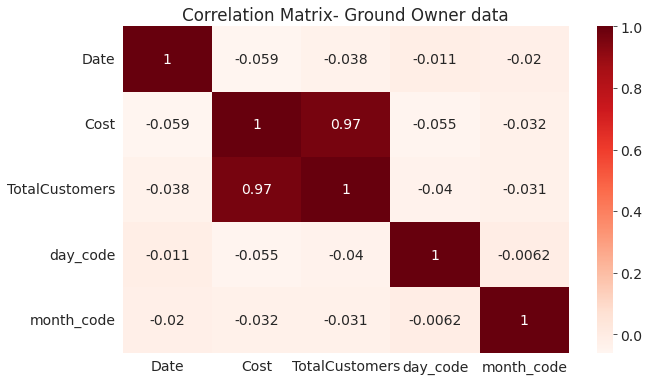

In [117]:
correlation_matrix_ground(gO1_Cost_df)

AxesSubplot(0.125,0.125;0.62x0.755)


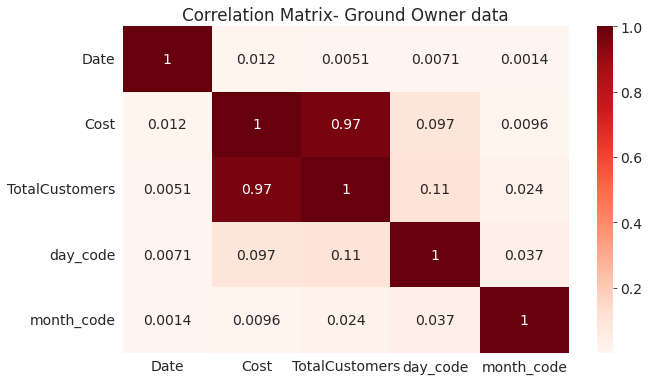

In [118]:
correlation_matrix_ground(gO2_Cost_df)

AxesSubplot(0.125,0.125;0.62x0.755)


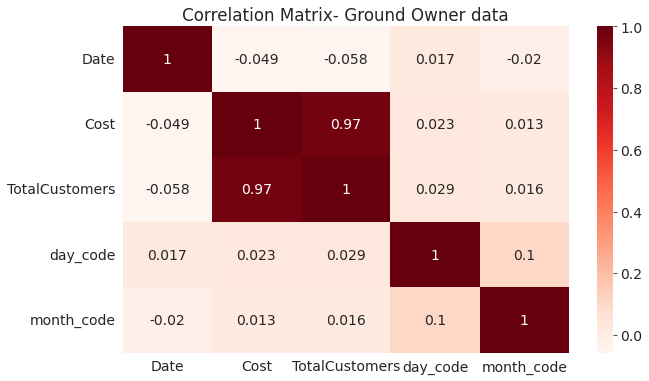

In [119]:
correlation_matrix_ground(gO3_Cost_df)

AxesSubplot(0.125,0.125;0.62x0.755)


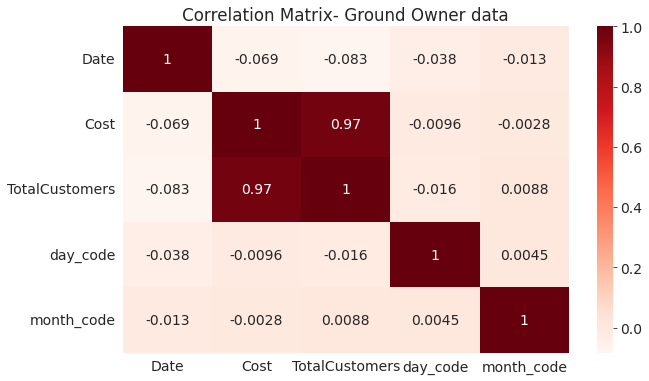

In [120]:
correlation_matrix_ground(gO4_Cost_df)

AxesSubplot(0.125,0.125;0.62x0.755)


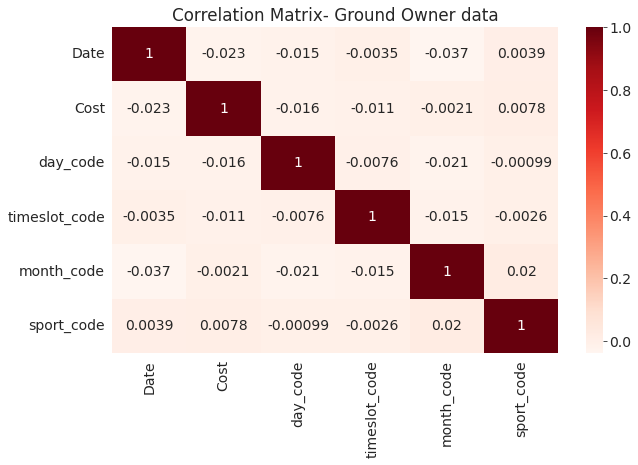

In [121]:
correlation_matrix_cust(gO1_Cust_df)

AxesSubplot(0.125,0.125;0.62x0.755)


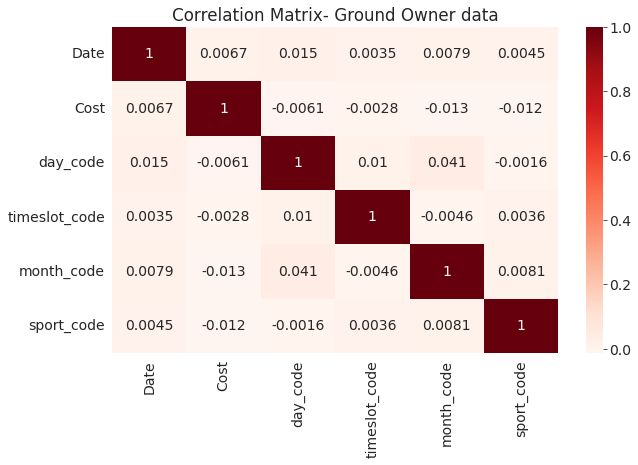

In [122]:
correlation_matrix_cust(gO2_Cust_df)

AxesSubplot(0.125,0.125;0.62x0.755)


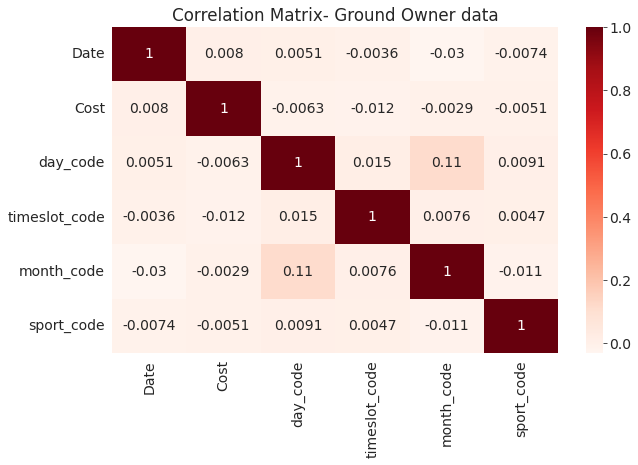

In [123]:
correlation_matrix_cust(gO3_Cust_df)

AxesSubplot(0.125,0.125;0.62x0.755)


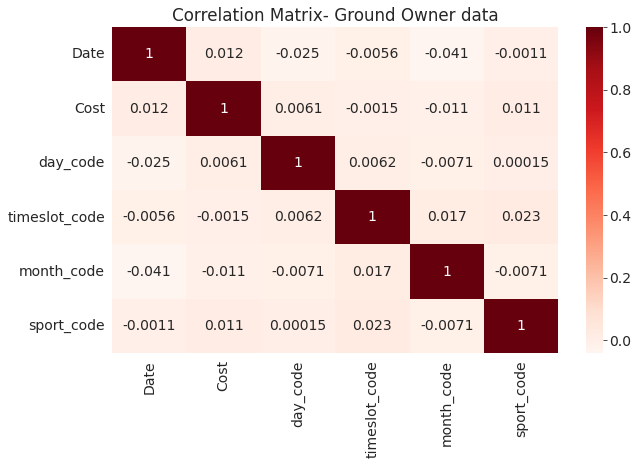

In [124]:
correlation_matrix_cust(gO4_Cust_df)

# Preprocessing for fitting into Models

In [125]:
print(gO1_Cost_df.shape)
gO1_Cost_df.head()

(765, 9)


,Date,Year,Day,Month,GroundName,Cost,TotalCustomers,day_code,month_code
1,2,2010,Friday,February,Ground1,6200,25,4,1
5,6,2010,Wednesday,January,Ground1,2850,14,2,0
9,10,2010,Friday,April,Ground1,4050,17,4,3
16,17,2010,Tuesday,December,Ground1,6600,28,1,11
20,21,2010,Thursday,August,Ground1,7650,29,3,7


In [126]:
gO1_Cost_df.nunique()

Date              765
Year               12
Day                 7
Month              12
GroundName          1
Cost              149
TotalCustomers     26
day_code            7
month_code         12
dtype: int64

In [127]:
gO1_Cost_df = gO1_Cost_df.drop(['Date','Year','GroundName','day_code','month_code'],axis=1)
# gO1_Cost_df = pd.get_dummies(gO1_Cost_df,drop_first=True)
gO1_Cost_df.head()

,Day,Month,Cost,TotalCustomers
1,Friday,February,6200,25
5,Wednesday,January,2850,14
9,Friday,April,4050,17
16,Tuesday,December,6600,28
20,Thursday,August,7650,29


In [128]:
gO1_Cost_df.shape

(765, 4)

In [129]:
print(gO1_Cust_df.shape)
gO1_Cust_df.head()

(12524, 12)


,Date,Year,Day,Month,TimeSlot,Sport,GroundName,Cost,day_code,timeslot_code,month_code,sport_code
23,2,2010,Friday,February,timeslot1,sport3,Ground1,450,4,0,1,2
24,2,2010,Friday,February,timeslot4,sport2,Ground1,300,4,3,1,1
25,2,2010,Friday,February,timeslot1,sport6,Ground1,200,4,0,1,5
26,2,2010,Friday,February,timeslot2,sport6,Ground1,400,4,1,1,5
27,2,2010,Friday,February,timeslot6,sport2,Ground1,250,4,5,1,1


In [130]:
gO1_Cust_df.nunique()

Date             765
Year              12
Day                7
Month             12
TimeSlot           7
Sport              6
GroundName         1
Cost               9
day_code           7
timeslot_code      7
month_code        12
sport_code         6
dtype: int64

In [131]:
gO1_Cust_df = gO1_Cust_df.drop(['Date','Year','GroundName','day_code','month_code','timeslot_code','sport_code'],axis=1)
# gO1_Cust_df = pd.get_dummies(gO1_Cust_df,drop_first=True)
gO1_Cust_df.head()

,Day,Month,TimeSlot,Sport,Cost
23,Friday,February,timeslot1,sport3,450
24,Friday,February,timeslot4,sport2,300
25,Friday,February,timeslot1,sport6,200
26,Friday,February,timeslot2,sport6,400
27,Friday,February,timeslot6,sport2,250


In [132]:
gO1_Cust_df.columns

Index(['Day', 'Month', 'TimeSlot', 'Sport', 'Cost'], dtype='object')

# Linear, Lasso , Ridge Models

In [137]:
linear_1 = gO1_Cost_df[['TotalCustomers','Cost']]
print(linear_1.shape)
linear_1.head()

(765, 2)


,TotalCustomers,Cost
1,25,6200
5,14,2850
9,17,4050
16,28,6600
20,29,7650


Text(0, 0.5, 'Revenue of that day')

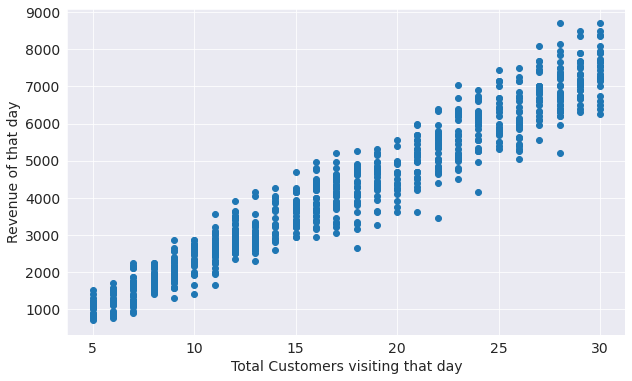

In [140]:
plt.scatter(linear_1['TotalCustomers'],linear_1['Cost'])
plt.xlabel('Total Customers visiting that day')
plt.ylabel('Revenue of that day')

In [142]:
linear_1_X = linear_1.iloc[:,0:1]
linear_1_y = linear_1.iloc[:,-1]

,TotalCustomers
1,25
5,14
9,17
16,28
20,29


In [143]:
linear_1_X.head()

,TotalCustomers
1,25
5,14
9,17
16,28
20,29


In [144]:
linear_1_y.head()

1     6200
5     2850
9     4050
16    6600
20    7650
Name: Cost, dtype: int64

In [145]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(linear_1_X,linear_1_y,test_size = 0.2,random_state=2)

In [147]:
from sklearn.linear_model import LinearRegression
lr_1 = LinearRegression()


In [148]:
lr_1.fit(X_train,y_train)

LinearRegression()

In [150]:
X_test.head()

,TotalCustomers
1994,27
2845,8
2515,5
2303,12
286,30


In [151]:
y_test.head()

1994    7450
2845    1600
2515     700
2303    2600
286     7150
Name: Cost, dtype: int64

In [154]:
X_test.iloc[1]

TotalCustomers    8
Name: 2845, dtype: int64

In [155]:
lr_1.predict(X_test.iloc[1].values.reshape(1,1))

array([1791.35154713])

In [171]:
#regression metrics 


Text(0, 0.5, 'Revenue of that day')

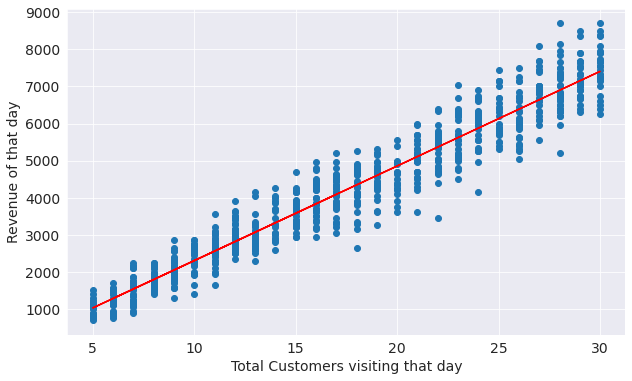

In [170]:
# line of best fit : 
plt.scatter(linear_1['TotalCustomers'],linear_1['Cost'])
plt.plot(X_train.to_numpy(),lr_1.predict(X_train),color='red')
plt.xlabel('Total Customers visiting that day')
plt.ylabel('Revenue of that day')

In [176]:
w_lr_1 = lr_1.coef_
b_lr_1 = lr_1.intercept_
print('weight:'+str(w_lr_1))
print('bias :'+str(b_lr_1))
# revenue = w * totalCust + b

weight:[255.2920606]
bias :-250.98493763486294


In [178]:
gO1_Cost_df

,Day,Month,Cost,TotalCustomers
1,Friday,February,6200,25
5,Wednesday,January,2850,14
9,Friday,April,4050,17
16,Tuesday,December,6600,28
20,Thursday,August,7650,29
...,...,...,...,...
2966,Sunday,September,4350,16
2970,Thursday,September,6200,28
2982,Monday,September,5200,23
2987,Thursday,August,5000,22


In [180]:
linear_2 = pd.get_dummies(gO1_Cost_df,drop_first=True)
print(linear_2.shape)
print(linear_2.columns)
linear_2.head()

(765, 19)
Index(['Cost', 'TotalCustomers', 'Day_Monday', 'Day_Saturday', 'Day_Sunday',
       'Day_Thursday', 'Day_Tuesday', 'Day_Wednesday', 'Month_August',
       'Month_December', 'Month_February', 'Month_January', 'Month_July',
       'Month_June', 'Month_March', 'Month_May', 'Month_November',
       'Month_October', 'Month_September'],
      dtype='object')


,Cost,TotalCustomers,Day_Monday,Day_Saturday,Day_Sunday,Day_Thursday,Day_Tuesday,Day_Wednesday,Month_August,Month_December,Month_February,Month_January,Month_July,Month_June,Month_March,Month_May,Month_November,Month_October,Month_September
1,6200,25,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0
5,2850,14,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0
9,4050,17,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
16,6600,28,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0
20,7650,29,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0


In [ ]:
# 18 dimensional hyperplane
# cost = b0 + b1.totCust + b2.day_mon + ... +b17.month_sept 


In [181]:
# hyperplane for 3d data 
from sklearn.datasets import make_regression
import plotly.express as px
import plotly.graph_objects as go

from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

In [182]:
try_X,try_y = make_regression(n_samples = 1000, n_features = 2, n_informative=2,n_targets= 1,noise=50)


In [183]:
try_df = pd.DataFrame({'feature1':try_X[:,0],'feature2':try_X[:,1],'target':try_y})

In [184]:
try_df.head()

,feature1,feature2,target
0,0.980541,-0.559701,-26.286742
1,-0.479169,0.343143,8.668616
2,-1.052579,0.256909,10.237333
3,0.285439,-0.346260,-22.418610
4,-0.027461,-0.749911,-57.500666


In [185]:
try_df.shape

(1000, 3)

In [186]:
try_fig = px.scatter_3d(try_df,x='feature1',y='feature2',z='target')

In [187]:
try_fig.show()

# Decision Tree

# Random Forest 

# XG Boosting